### Importando bibliotecas

In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import folium
from folium import plugins
import matplotlib.pyplot as plt
import json
import geopandas as gpd
import warnings
from shapely.geometry import Point

### Definiendo templates para plotear

In [2]:
#px.defaults.template = "ggplot2"
px.defaults.template = "seaborn"

#plt.style.use('fivethirtyeight')

warnings.filterwarnings('ignore')

- Se realiza la lectura de un archivo CSV que contiene datos agrícolas en un DataFrame de Pandas.
- Se crea una nueva columna llamada 'Excedente' en el DataFrame, que calcula la diferencia entre las columnas 'Sembrada' y 'Cosechada'.
- Se crea un nuevo DataFrame llamado df que contiene solo las columnas de interés.

In [3]:
d_frame = pd.read_csv('Data/Cierre_agricola__2003_2023_Clean.csv')
d_frame['Excedente'] = d_frame['Sembrada'] - d_frame['Cosechada'] 
columns = ['Anio', 'Idestado','Nomestado','Idmunicipio', 'Nommunicipio', 'Sembrada', 'Cosechada', 'Excedente']
df = d_frame[columns]

In [4]:
df_estados1 = df.groupby(['Anio','Idestado','Nomestado']).sum().reset_index()
df_estados = df_estados1[['Anio','Idestado','Nomestado','Sembrada', 'Cosechada', 'Excedente']]
df_estados

,Anio,Idestado,Nomestado,Sembrada,Cosechada,Excedente
0,2003,1,Aguascalientes,153843.00,148890.00,4953.00
1,2003,2,Baja California,235956.10,217146.10,18810.00
2,2003,3,Baja California Sur,36458.20,33337.35,3120.85
3,2003,4,Campeche,229257.55,189956.34,39301.21
4,2003,5,Coahuila,297136.33,272986.83,24149.50
...,...,...,...,...,...,...
635,2022,28,Tamaulipas,1203724.81,1146376.39,57348.42
636,2022,29,Tlaxcala,233350.33,233277.33,73.00
637,2022,30,Veracruz,1552141.98,1507973.43,44168.55
638,2022,31,Yucatán,706130.13,701561.42,4568.71


In [5]:
df_municipio = df.groupby(['Anio','Idestado','Nomestado','Idmunicipio','Nommunicipio']).sum().reset_index()
df_municipio['Idmunicipio'] = df_municipio['Idmunicipio'].astype(str).str.zfill(3)
df_municipio['Idestado'] = df_municipio['Idestado'].astype(str).str.zfill(2)
print(df_municipio.shape)
df_municipio

(48616, 8)


,Anio,Idestado,Nomestado,Idmunicipio,Nommunicipio,Sembrada,Cosechada,Excedente
0,2003,01,Aguascalientes,001,Aguascalientes,31708.00,31083.00,625.0
1,2003,01,Aguascalientes,002,Asientos,20142.00,20001.00,141.0
2,2003,01,Aguascalientes,003,Calvillo,11986.00,11829.00,157.0
3,2003,01,Aguascalientes,004,Cosío,7101.00,6974.00,127.0
4,2003,01,Aguascalientes,005,Jesús María,12124.00,12099.00,25.0
...,...,...,...,...,...,...,...,...
48611,2022,32,Zacatecas,054,Villa Hidalgo,12944.72,12944.72,0.0
48612,2022,32,Zacatecas,055,Villanueva,23366.50,23342.50,24.0
48613,2022,32,Zacatecas,056,Zacatecas,10954.83,10954.83,0.0
48614,2022,32,Zacatecas,057,Trancoso,8050.99,8050.99,0.0


### Plot Estados

In [6]:
df_estados_2022 = df_estados[df_estados['Anio'] == 2022]
geojson_file_estados = 'Geojson_Mex/Estados_Mexico_WGS84.json'
gdf_estados = gpd.read_file(geojson_file_estados)

### Plot estado Geopandas

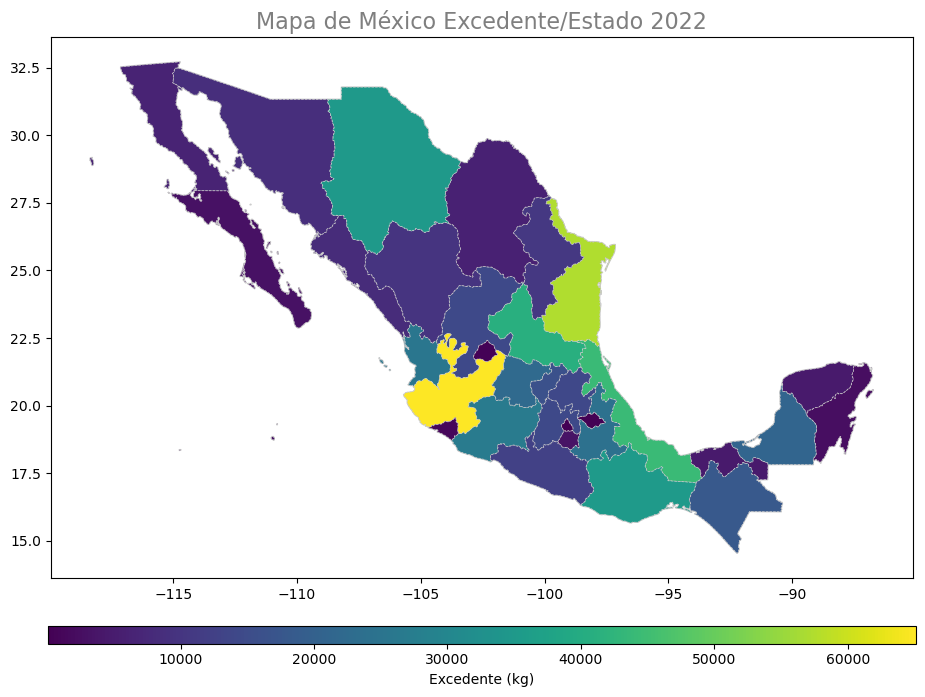

In [7]:
# Combinar el DataFrame y el GeoDataFrame en función de una columna común
merged_estados = gdf_estados.join(df_estados_2022.set_index('Nomestado'), on='name', how='left')

# Crear el mapa de cloropletas para los estados
fig, ax = plt.subplots(1, 1, figsize=(16, 9))

gdf_estados.plot(ax=ax, 
                 color='lightgray', 
                 edgecolor='0.8')

merged_estados.plot(column='Excedente', 
            cmap='viridis', 
            linewidth=0.5,
            linestyle='dashed', 
            ax=ax, 
            edgecolor='0.8',
            legend=True,
            legend_kwds={'label': "Excedente (kg)", 'orientation': "horizontal", 'shrink': 0.7, 'pad': 0.07, 'aspect': 50})

# Agregar un título al mapa
plt.title('Mapa de México Excedente/Estado 2022',fontsize=16, color='#7f7f7f')

# Mostrar el mapa
plt.show()

### Plot estado Plotly

In [8]:
with open(geojson_file_estados, 'r') as file:
    mx_estados_geo = json.load(file)

fig1 = px.choropleth(data_frame=df_estados_2022, 
                    geojson=mx_estados_geo, 
                    locations='Nomestado', # nombre de la columna del Dataframe
                    featureidkey='properties.name',  # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
                    color='Excedente',
                    color_continuous_scale="viridis"
                   )
fig1.update_geos(fitbounds="locations",
                showcountries=False, 
                showcoastlines=False, 
                #showland=True, landcolor="LightGreen",
                #showocean=True, oceancolor="LightBlue",
                )
fig1.update_layout(
    title_text = 'Mapa de México Excedente/Estado 2022',
    font=dict(
    size=18,
    color="#7f7f7f"
    ),
    title_x=0.5,
    width=1280,
    height=720
)
#fig1.show()

### Plot estado Folium

In [9]:
merged_estados['Excedente'] = merged_estados['Excedente'].apply(lambda x: round(x, 2))
merged_estados.head()

,name,id,CNTRY,TYPE,geometry,Anio,Idestado,Sembrada,Cosechada,Excedente
0,Zacatecas,MX-ZAC,Mexico,State,"POLYGON ((-100.83230 24.55490, -100.85400 24.5...",2022,32,1157673.06,1143383.15,14289.91
1,Yucatán,MX-YUC,Mexico,State,"POLYGON ((-87.53860 21.48640, -87.53090 21.460...",2022,31,706130.13,701561.42,4568.71
2,Veracruz,MX-VER,Mexico,State,"MULTIPOLYGON (((-97.40280 21.48100, -97.42600 ...",2022,30,1552141.98,1507973.43,44168.55
3,Tlaxcala,MX-TLA,Mexico,State,"POLYGON ((-98.58490 19.46750, -98.60570 19.490...",2022,29,233350.33,233277.33,73.00
4,Tamaulipas,MX-TAM,Mexico,State,"MULTIPOLYGON (((-97.71640 24.27670, -97.71350 ...",2022,28,1203724.81,1146376.39,57348.42


In [10]:
attr = ('Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community')
tiles = "https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}'"

mx_estados = folium.Map(
                    location=[23.6345, -102.5528], 
                    zoom_start=6,
                    control_scale=True,
                    tiles=folium.TileLayer(tiles, attr=attr,no_wrap=True),                  
                    prefer_canvas=True,)

choropleth_estados = folium.Choropleth(
    name ='Choropleth Estados/Excedente 2022',
    geo_data = merged_estados, # archivo geojson                          
    data = merged_estados,                     
    columns = ['name', 'Excedente'], # columnas del dataframe, la primera es la que se relaciona con el archivo geojson
    key_on='feature.properties.name', # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
    fill_color ='viridis',
    fill_opacity = 0.8,
    line_opacity = 0.6,
    line_color='white',
    legend_name = "Mapa de México Estados/Excedente 2022",
    highlight=True,
    smooth_factor=0,
    overlay=True,
    bins = list(merged_estados['Excedente'].quantile([0, 0.3, 0.6, 0.90, 1])) # bins para la leyenda, en este caso cuartiles, pero pueden ser los que ustedes quieran o quitarse de plano
   
   ).add_to(mx_estados)


# Agregar un control de capas al mapa
folium.TileLayer("cartodbpositron").add_to(mx_estados)
folium.TileLayer("openstreetmap").add_to(mx_estados)
folium.TileLayer("cartodbdark_matter").add_to(mx_estados)

# Agregar un tooltip con información
folium.GeoJsonTooltip(
    fields=['name','Excedente'],
    aliases=['Estado: ','Excedente: '],        

).add_to(choropleth_estados.geojson)

plugins.MiniMap().add_to(mx_estados) # agrega minimapa
folium.LayerControl().add_to(mx_estados) # agrega control de capas

# salvar el mapa como archivo html
mx_estados.save('Out_map/Choropleth Estados-Excedente.html')

mx_estados

### Centroide Estados Mexico

In [11]:
# Crea un GeoDataFrame con los centroides
df_estado_centroide = pd.DataFrame({
    'Estado': gdf_estados['name'],
    'Estado_ID': gdf_estados['id'],
    'centroid_lat': gdf_estados['geometry'].centroid.y,
    'centroid_lon': gdf_estados['geometry'].centroid.x
})

# Verifica si los centroides pertenecen a la geometría de los municipios
df_estado_centroide['Pertenece'] = df_estado_centroide.apply(
    lambda row: gdf_estados.geometry.contains(Point(row['centroid_lon'], row['centroid_lat'])).any(), axis=1
)

# Guarda el resultado en un archivo CSV
df_estado_centroide.to_csv('Geojson_Mex/Coordenadas_Centroide_Estado.csv', index=False)

print(df_estado_centroide['Pertenece'].value_counts())
df_estado_centroide.head()

True    32
Name: Pertenece, dtype: int64


,Estado,Estado_ID,centroid_lat,centroid_lon,Pertenece
0,Zacatecas,MX-ZAC,23.266403,-102.708831,True
1,Yucatán,MX-YUC,20.779755,-88.927237,True
2,Veracruz,MX-VER,19.351889,-96.378018,True
3,Tlaxcala,MX-TLA,19.452613,-98.083483,True
4,Tamaulipas,MX-TAM,24.300779,-98.674508,True


# Municipios

In [12]:
df_municipio_2022 = df_municipio[df_municipio['Anio'] == 2022]
geojson_file_municipio = 'Geojson_Mex/Municipios_Mexico_WGS84.json'
gdf_municipio = gpd.read_file(geojson_file_municipio)
#merged_municipio = gdf_municipio.join(df_municipio_2022.set_index('Nommunicipio'), on='NOM_MUN', how='inner')
merged_municipio = gdf_municipio.join(df_municipio_2022.set_index('Nommunicipio'), on='NOM_MUN', how='left')

### Plot municipios Geopandas

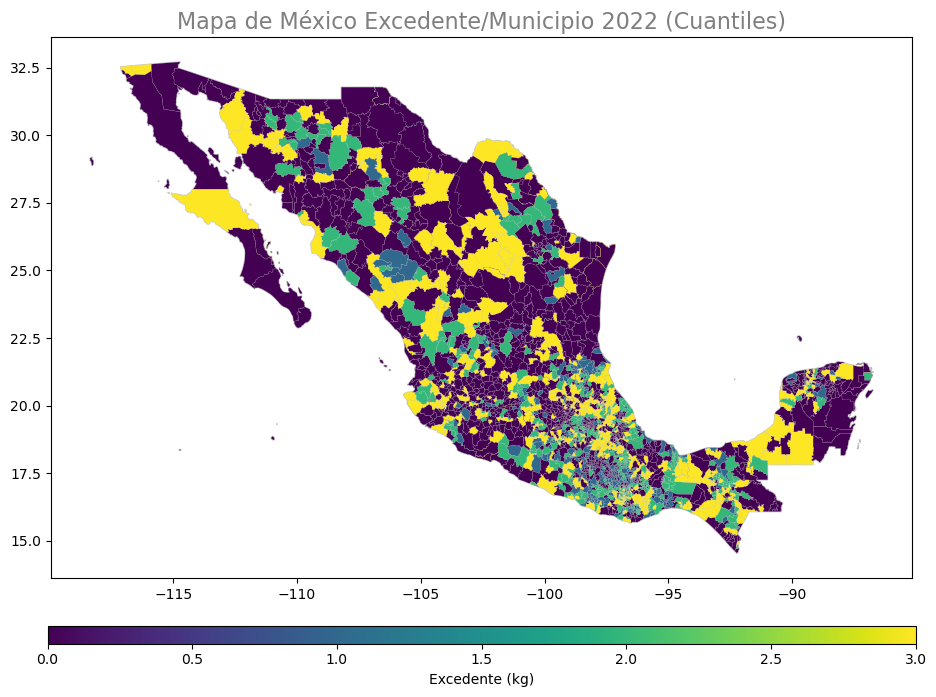

In [13]:
import mapclassify as mc

# Supongamos que 'merged_municipio' es tu GeoDataFrame combinado con los datos
# y 'Excedente' es la columna que deseas mapear.

# Clasificar los datos en cuantiles usando Quantiles
classifier = mc.Quantiles(merged_municipio['Excedente'], k=5)  # k es el número de cuantiles

# Crear una nueva columna en el GeoDataFrame con las categorías de cuantiles
merged_municipio['Excedente_Quantiles'] = classifier.yb

# Crear el mapa de cloropletas para los estados con cuantiles
fig, ax = plt.subplots(1, 1, figsize=(16, 9))

gdf_municipio.plot(ax=ax, color='lightgray', edgecolor='0.8')

merged_municipio.plot(column='Excedente_Quantiles', 
            cmap='viridis', 
            linewidth=0.1,
            ax=ax, 
            edgecolor='0.8',
            legend=True,
            legend_kwds={'label': "Excedente (kg)", 'orientation': "horizontal", 'shrink': 0.7, 'pad': 0.07, 'aspect': 50})

# Agregar un título al mapa
plt.title('Mapa de México Excedente/Municipio 2022 (Cuantiles)', fontsize=16, color='#7f7f7f')

# Mostrar el mapa
plt.show()

In [14]:
# Realizar el merge utilizando las columnas especificadas
#merged_municipio = gdf_municipio.merge(df_municipio_2022, left_on=['NOM_MUN', 'CVE_ENT'], right_on=['Idmunicipio', 'Idestado'], how='left')
#merged_municipio = gdf_municipio.merge(df_municipio_2022, left_on=['NOM_MUN', 'CVE_ENT'], right_on=['Idmunicipio', 'Idestado'], how='inner')
#merged_municipio

# Combinar el DataFrame y el GeoDataFrame en función de una columna común
#merged_municipio = gdf_municipio.join(df_municipio_2022.set_index('Nommunicipio'), on='NOM_MUN', how='inner')
# merged_municipio = gdf_municipio.join(df_municipio_2022.set_index('Nommunicipio'), on='NOM_MUN', how='left')
# print(merged_municipio.isna().sum())
# merged_municipio

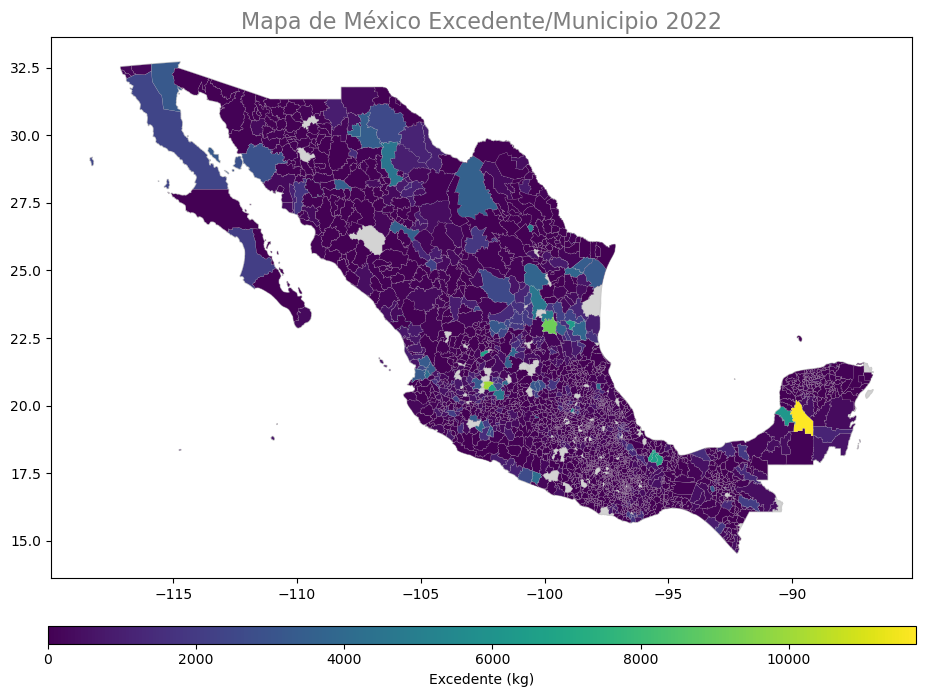

In [15]:
# Crear el mapa de cloropletas para los municipios
fig, ax = plt.subplots(1, 1, figsize=(16, 9))

gdf_municipio.plot(ax=ax, 
                 color='lightgray', 
                 edgecolor='0.8')

merged_municipio.plot(column='Excedente', 
            cmap='viridis', 
            linewidth=0.1,
            #linestyle='dashed', 
            ax=ax, 
            edgecolor='0.8',                       
            legend=True,
            legend_kwds={'label': "Excedente (kg)", 'orientation': "horizontal", 'shrink': 0.7, 'pad': 0.07, 'aspect': 50})

# Agregar un título al mapa
plt.title('Mapa de México Excedente/Municipio 2022',fontsize=16, color='#7f7f7f')

# Mostrar el mapa
plt.show()

### Plot Municipio Plotly: Esto da cosas raras

In [16]:
with open(geojson_file_municipio, 'r') as file:
    mx_municipio_geo = json.load(file)

fig1 = px.choropleth(data_frame=df_municipio_2022,
                    geojson=mx_municipio_geo,
                    locations='Nommunicipio', # nombre de la columna del Dataframe
                    featureidkey='properties.NOM_MUN',  # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los municipios)
                    color='Excedente',
                    color_continuous_scale="viridis"
                   )
fig1.update_geos(fitbounds="locations",
                showcountries=False,
                showcoastlines=False
                )
fig1.update_layout(
    title_text = 'Mapa de México Excedente/Municipio 2022',
    font=dict(
    size=18,
    color="#7f7f7f"
    ),
    title_x=0.5,
    width=800,
    height=500
)
fig1.show()

### Plot Municipio Folium

In [17]:
merged_municipio['Excedente'] = merged_municipio['Excedente'].apply(lambda x: round(x, 2))
merged_municipio

,CVE_ENT,CVE_MUN,NOM_MUN,geometry,Anio,Idestado,Nomestado,Idmunicipio,Sembrada,Cosechada,Excedente,Excedente_Quantiles
0,01,002,Asientos,"POLYGON ((-101.99941 22.21951, -102.00247 22.2...",2022.0,01,Aguascalientes,002,16566.66,16562.66,4.0,1
1,01,011,San Francisco de los Romo,"POLYGON ((-102.19104 22.06610, -102.21148 22.0...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
2,01,007,Rincón de Romos,"POLYGON ((-102.18902 22.36244, -102.21198 22.3...",2022.0,01,Aguascalientes,007,13112.34,13109.34,3.0,1
3,01,008,San José de Gracia,"POLYGON ((-102.35385 22.12064, -102.36056 22.1...",2022.0,01,Aguascalientes,008,2888.00,2888.00,0.0,0
4,01,005,Jesús María,"POLYGON ((-102.54085 21.80636, -102.52812 21.8...",2022.0,01,Aguascalientes,005,8869.45,8869.45,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2453,15,090,Tenango del Valle,"POLYGON ((-99.77168 19.06518, -99.73269 19.062...",2022.0,15,México,090,9687.39,9687.39,0.0,0
2454,15,106,Toluca,"POLYGON ((-99.64705 19.22109, -99.63596 19.230...",2022.0,15,México,106,15140.67,15140.67,0.0,0
2455,15,058,Nezahualcóyotl,"POLYGON ((-99.04845 19.43913, -99.05721 19.409...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
2456,09,005,Gustavo A. Madero,"POLYGON ((-99.09056 19.50955, -99.09089 19.509...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [23]:

mx_municipio = folium.Map(
                    location=[23.6345, -102.5528], 
                    zoom_start=6,
                    control_scale=True,
                    tiles=folium.TileLayer(tiles, attr=attr,no_wrap=True),                  
                    prefer_canvas=True,)


choropleth_municipio = folium.Choropleth(
    name ='Choropleth Municipio/Excedente 2022',
    geo_data = merged_municipio, # archivo geojson                          
    data = merged_municipio,                     
    columns = ['NOM_MUN', 'Excedente'], # columnas del dataframe, la primera es la que se relaciona con el archivo geojson
    key_on='feature.properties.NOM_MUN', # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
    fill_color ='viridis',
    fill_opacity = 0.8,
    line_opacity = 0.3,
    line_color='white',
    legend_name = "Mapa de México Municipio/Excedente 2022",
    highlight=True,
    smooth_factor=0,
    overlay=True,
    bins = list(merged_municipio['Excedente'].quantile([0, 0.9, 0.98, 0.995, 1])) # bins para la leyenda, en este caso cuartiles, pero pueden ser los que ustedes quieran o quitarse de plano
   
   ).add_to(mx_municipio)


# Agregar un control de capas al mapa
folium.TileLayer("cartodbpositron").add_to(mx_municipio)
folium.TileLayer("openstreetmap").add_to(mx_municipio)
folium.TileLayer("cartodbdark_matter").add_to(mx_municipio)

# Agregar un tooltip con información
folium.GeoJsonTooltip(
    fields=['NOM_MUN','Excedente'],
    aliases=['Municipio: ','Excedente: '],        

).add_to(choropleth_municipio.geojson)

folium.LayerControl().add_to(mx_municipio)

# salvar el mapa como archivo html
#mx_municipio.save('Out_map/Choropleth Municipio-Excedente.html')

mx_municipio

### Tree Map estados/municipios Plotly

In [19]:
fig = px.treemap(df_municipio_2022, 
                path=[px.Constant('Mexico'),'Nomestado', 'Nommunicipio'], 
                values='Excedente',
                #color='Sembrada', 
                #hover_data=['iso_alpha'],
                #color_continuous_scale='greens',
                #color_continuous_midpoint=None
                #color_continuous_midpoint=np.average(df['Sembrada'], weights=df['Excedente'])
                )
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig.data[0].textinfo = 'label+text+value'

fig.update_layout(
    title_text = 'TreeMap Excedente/Estado 2022',
    font=dict(
    #size=18,
    #color="#7f7f7f"
    ),
    title_x=0.5,
    width=1280,
    height=720
)
#fig.show()

### Centroides Municipios Mexico

In [24]:
# Crea un GeoDataFrame con los centroides
df_municipio_centroide = pd.DataFrame({
    'Estado_CVE': gdf_municipio['CVE_ENT'],
    'Municipio_CVE': gdf_municipio['CVE_MUN'],
    'Municipio': gdf_municipio['NOM_MUN'],
    'centroid_lat': gdf_municipio['geometry'].centroid.y,
    'centroid_lon': gdf_municipio['geometry'].centroid.x
})

# Verifica si los centroides pertenecen a la geometría de los municipios
df_municipio_centroide['Pertenece'] = df_municipio_centroide.apply(
    lambda row: gdf_municipio.geometry.contains(Point(row['centroid_lon'], row['centroid_lat'])).any(), axis=1
)

# Guarda el resultado en un archivo CSV
df_municipio_centroide.to_csv('Geojson_Mex/Coordenadas_Centroide_Municipio.csv', index=False)

print(df_municipio_centroide['Pertenece'].value_counts())
df_municipio_centroide.head()

True     2454
False       4
Name: Pertenece, dtype: int64


,Estado_CVE,Municipio_CVE,Municipio,centroid_lat,centroid_lon,Pertenece
0,01,002,Asientos,22.126737,-102.045605,True
1,01,011,San Francisco de los Romo,22.033110,-102.228397,True
2,01,007,Rincón de Romos,22.267232,-102.340802,True
3,01,008,San José de Gracia,22.146885,-102.525446,True
4,01,005,Jesús María,21.932282,-102.445932,True


# Test

In [21]:
#print(df_municipio_centroide.value_counts('Municipio_CVE'))
print(df_municipio_centroide.shape)
df_municipio_centroide.head(10)

(2458, 6)


,Estado_CVE,Municipio_CVE,Municipio,centroid_lat,centroid_lon,Pertenece
0,01,002,Asientos,22.126737,-102.045605,True
1,01,011,San Francisco de los Romo,22.033110,-102.228397,True
2,01,007,Rincón de Romos,22.267232,-102.340802,True
3,01,008,San José de Gracia,22.146885,-102.525446,True
4,01,005,Jesús María,21.932282,-102.445932,True
5,01,009,Tepezalá,22.237026,-102.192754,True
6,01,001,Aguascalientes,21.811537,-102.295376,True
7,01,006,Pabellón de Arteaga,22.104190,-102.302502,True
8,01,010,El Llano,21.922314,-102.035316,True
9,01,003,Calvillo,21.900986,-102.705249,True


In [25]:
#print(df_municipio_2022.value_counts('Idmunicipio'))
print(df_municipio_2022.shape)
df_municipio_2022.head(10)

(2446, 8)


,Anio,Idestado,Nomestado,Idmunicipio,Nommunicipio,Sembrada,Cosechada,Excedente
46170,2022,01,Aguascalientes,001,Aguascalientes,22691.20,22605.20,86.00
46171,2022,01,Aguascalientes,002,Asientos,16566.66,16562.66,4.00
46172,2022,01,Aguascalientes,003,Calvillo,9459.30,9262.95,196.35
46173,2022,01,Aguascalientes,004,Cosío,5836.00,5821.00,15.00
46174,2022,01,Aguascalientes,005,Jesús María,8869.45,8869.45,0.00
46175,2022,01,Aguascalientes,006,Pabellón de Arteaga,7493.00,7457.00,36.00
46176,2022,01,Aguascalientes,007,Rincón de Romos,13112.34,13109.34,3.00
46177,2022,01,Aguascalientes,008,San José de Gracia,2888.00,2888.00,0.00
46178,2022,01,Aguascalientes,009,Tepezalá,9271.35,9271.35,0.00
46179,2022,01,Aguascalientes,010,El Llano,14812.50,14808.50,4.00
